In [1]:
from collections import defaultdict

import numpy as np
import pandas as pd
import plotly as plt
import plotly.express as px
import scipy.stats
import tensorflow as tf
import tensorflow_addons as tfa
import tensorflow_probability as tfp

tfkl = tf.keras.layers
tfk = tf.keras
tfd = tfp.distributions
tfko = tf.keras.optimizers
tfpl = tfp.layers
tfb = tfp.bijectors

# Ripe rimu in 2002 and 2019 on Whenua Hou, 2016 and 2019 on Anchor

# Notes

I think egg weight _may_ be helping but with so many missing ones it's hard to tell. Need to re-download and parse the new file (some columns changed) and see if that keeps the same number of training examples...

In [2]:
weights = pd.read_csv("chick_growth_weights.csv")

bird_count = weights.nunique()["birdName"]
bird_id = range(bird_count)
bird_to_id = dict(zip(weights["birdName"].unique(), bird_id))
id_to_bird = {y: x for x, y in bird_to_id.items()}

year_count = weights.nunique()["birth_year"]
year_id = range(year_count)
year_to_id = dict(zip(weights["birth_year"].unique(), year_id))
id_to_year = {y: x for x, y in year_to_id.items()}

layisland_count = weights.nunique()["lay_island"]
layisland_id = range(layisland_count)
layisland_to_id = dict(zip(weights["lay_island"].unique(), layisland_id))
id_to_layisland = {y: x for x, y in layisland_to_id.items()}

nestmother_count = weights.nunique()["nestMother"]
nestmother_id = range(nestmother_count)
nestmother_to_id = dict(zip(weights["nestMother"].unique(), nestmother_id))
id_to_nestmother = {y: x for x, y in nestmother_to_id.items()}

[bird_count, year_count, layisland_count]

byisland = list()

for i, d in weights[["lay_island", "dateHatched"]].iterrows():
    by = d[1][0:4]
    island = d[0]
    byisland.append(str(by + "_" + island))

weights["island_by_year"] = byisland
weights

islandby_count = weights.nunique()["island_by_year"]
islandby_id = range(islandby_count)
islandby_to_id = dict(zip(weights["island_by_year"].unique(), islandby_id))
id_to_islandby = {y: x for x, y in layisland_to_id.items()}

weights["islandby"] = [
    islandby_to_id[d["island_by_year"]] for i, d in weights.iterrows()
]

In [3]:
day_var = defaultdict(list)
for i, j in weights[["day_floor", "weight"]].iterrows():
    day_var[j["day_floor"]].append(j["weight"])

In [4]:
day_vars = defaultdict(float)
for k, v in day_var.items():
    day_vars[int(k)] = np.std(v)

In [5]:
day_vars = sorted(day_vars.items())[:-1]

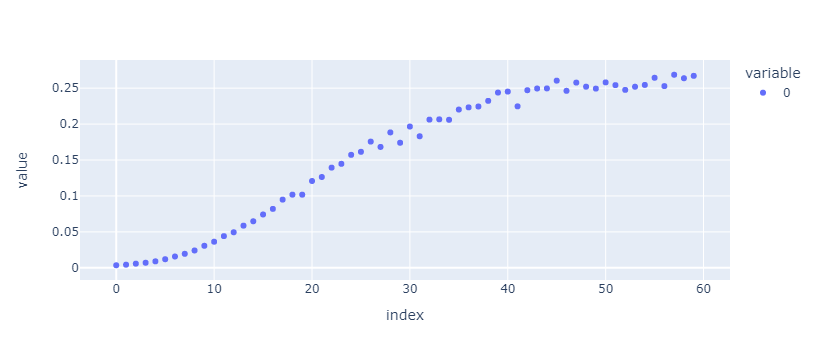

In [6]:
px.scatter([x[1] for x in day_vars])

In [7]:
# loc = tf.Variable(20., trainable=True)
# scale = tf.Variable(2., trainable=True)

VL = tfpl.VariableLayer(5, initializer=tf.random_uniform_initializer(-1.0, 1.0))

day = tfkl.Input(1)
vl = VL(day)
y = tfd.Logistic(loc=vl[0], scale=tf.math.abs(vl[1]))
y = vl[4] * tf.math.abs(vl[3] + vl[2] * y.cdf(day))

model = tfk.Model(inputs=[day], outputs=[y])

model.compile(
    loss="mape",
    optimizer=tfko.Adam(1e-2),
    #optimizer=tfa.optimizers.Lookahead(tfa.optimizers.AdamW(1e-1)),
    #optimizer=tfa.optimizers.AdamW(1e-2),
    metrics=["mae", "mape"],
)

out = model.fit(
    x=[x[0] for x in day_vars],
    y=[x[1] for x in day_vars],
    epochs=256,
    verbose=False,
    shuffle=True,
)

2022-05-31 13:48:55.633976: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-05-31 13:48:56.066005: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1532] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 6623 MB memory:  -> device: 0, name: NVIDIA GeForce GTX 1070 Ti, pci bus id: 0000:42:00.0, compute capability: 6.1


In [8]:
VL.weights

[<tf.Variable 'constant:0' shape=(5,) dtype=float32, numpy=
 array([-0.10005827,  1.0132179 , -0.55204535,  0.34009525,  0.07460581],
       dtype=float32)>]

In [9]:
model.compile(
    loss="mape",
    optimizer=tfko.Adam(1e-3),
    metrics=["mae", "mape"],
)

out = model.fit(
    x=[x[0] for x in day_vars],
    y=[x[1] for x in day_vars],
    epochs=8192,
    verbose=False,
    shuffle=True,
)

In [10]:
VL.weights

[<tf.Variable 'constant:0' shape=(5,) dtype=float32, numpy=
 array([ 3.5002382 , 14.60049   , -0.6792942 ,  0.31850988,  0.63192576],
       dtype=float32)>]

In [11]:
model.compile(
    loss="mape",
    optimizer=tfko.Adam(1e-4),
    metrics=["mae", "mape"],
)

out = model.fit(
    x=[x[0] for x in day_vars],
    y=[x[1] for x in day_vars],
    epochs=8192,
    verbose=False,
    shuffle=True,
)

In [12]:
VL.weights

[<tf.Variable 'constant:0' shape=(5,) dtype=float32, numpy=
 array([ 3.772355  , 15.9096775 , -0.68454766,  0.3188041 ,  0.6947216 ],
       dtype=float32)>]

In [13]:
model.compile(
    loss=["mape"],
    optimizer=tfko.Adam(1e-4),
    metrics=["mae", "mape", "mse"],
)

out = model.fit(
    x=[x[0] for x in day_vars],
    y=[x[1] for x in day_vars],
    epochs=8192,
    verbose=False,
    shuffle=True,
)

In [14]:
VL.weights

[<tf.Variable 'constant:0' shape=(5,) dtype=float32, numpy=
 array([ 4.024846  , 17.154018  , -0.68721527,  0.31931958,  0.7328819 ],
       dtype=float32)>]

In [15]:
y_pred = model.predict([x[0] for x in day_vars])

2/2 [==============================] - 0s 2ms/step


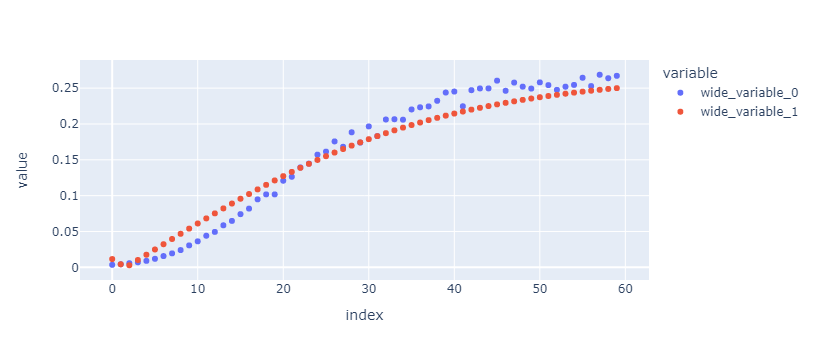

In [16]:
px.scatter(y=[[x[1] for x in day_vars], y_pred.flatten()])

In [17]:
VL.weights[0].numpy()

array([ 4.024846  , 17.154018  , -0.68721527,  0.31931958,  0.7328819 ],
      dtype=float32)

In [18]:
scale_variables = VL.weights[0].numpy()

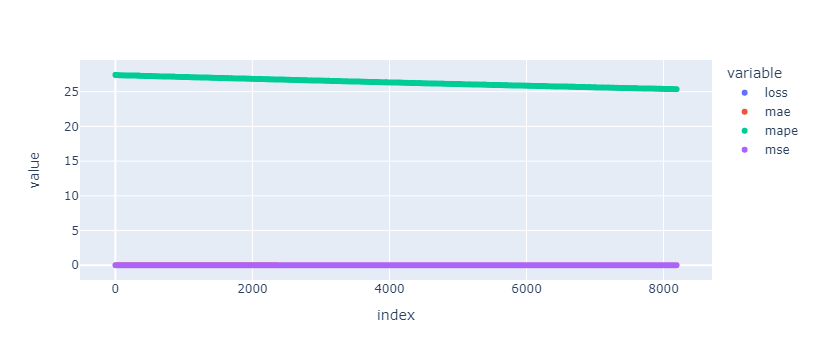

In [19]:
px.scatter(out.history)

# Data Generators

In [20]:
batch_size = 1024
batch_size = len(weights)

def gen():
    for _, data in weights.iterrows():
        s = 0
        if data["sex"] == "Male":
            s = 1
        yield (
            s,
            year_to_id[data["birth_year"]],
            layisland_to_id[data["lay_island"]],
            data["handreared"],
            data["islandby"],
            data["age"],
            data["RipeRimu"],
            nestmother_to_id[data["nestMother"]],
            data["hr_rr_code"],
            data['eggWeight'],
        ), data["weight"]


def vgen():
    for _, data in test.iterrows():
        s = 0
        if data["sex"] == "Male":
            s = 1
        yield (
            s,
            year_to_id[data["birth_year"]],
            layisland_to_id[data["lay_island"]],
            data["handreared"],
            data["islandby"],
            data["age"],
            data["RipeRimu"],
            nestmother_to_id[data["nestMother"]],
            data["hr_rr_code"],
            data['eggWeight'],
        ), data["weight"]
        
mask = np.random.rand(len(weights)) < 0.90
train = weights[mask]
test = weights[~mask]

os = ((tf.TensorSpec(shape=(10,))), tf.TensorSpec(shape=(), dtype=tf.float32))
ds = tf.data.Dataset.from_generator(gen, output_signature=os)
#ds = ds.cache().shuffle(len(train)*2).batch(batch_size)
ds = ds.cache().shuffle(len(train)).batch(len(train))

vds = tf.data.Dataset.from_generator(vgen, output_signature=os)
vds = vds.cache().shuffle(len(test)).batch(batch_size)

In [21]:
weights['RipeRimu'].unique()

array([1, 0])

# Normal Dist fn

In [22]:
def nd(name):
    m = tfk.Sequential(
        [
            tfpl.DistributionLambda(
                make_distribution_fn=lambda t: tfd.Independent(
                    tfd.Normal(loc=t[..., 0], 
                               scale=1e-6 + tfb.Softplus(hinge_softness=1e-10)(t[..., 1]), 
                               validate_args=True,
                               name=name)
                    #tfd.GeneralizedNormal(
                    #    loc=t[..., 0],
                    #    scale=1e-6 + tf.math.abs(t[..., 1]),
                    #    power=1.0 + t[..., 2],
                    #    validate_args=True,
                    #    allow_nan_stats=False,
                    #)
                ),
                convert_to_tensor_fn=lambda s: s.sample(),
            )
        ]
    )
    return m

def hnd(name):
    m = tfk.Sequential(
        [
            tfpl.DistributionLambda(
                make_distribution_fn=lambda t: tfd.Independent(
                    tfd.HalfNormal(loc=t[..., 0], 
                               scale=1e-6 + tfb.Softplus(hinge_softness=1e-10)(t[..., 1]), 
                               validate_args=True,
                               name=name)
                    #tfd.GeneralizedNormal(
                    #    loc=t[..., 0],
                    #    scale=1e-6 + tf.math.abs(t[..., 1]),
                    #    power=1.0 + t[..., 2],
                    #    validate_args=True,
                    #    allow_nan_stats=False,
                    #)
                ),
                convert_to_tensor_fn=lambda s: s.sample(),
            )
        ]
    )
    return m



# Logistic Regression -- Fit intercepts

# TODO: Fix this formula...
# $ y = M\frac{1}{1+e^{-(b_0+b_1X)}}     $

In [24]:
init = tfk.initializers.RandomUniform(0.1, 0.2)
init_tv = tfk.initializers.RandomUniform(0.1, 0.2)

model_input = tfk.Input(shape=(10, 1), name="input")

# Inputs
age = model_input[:, 5]

# Layers
TrainableVars = tfp.layers.VariableLayer(13, initializer=init_tv, name="TrainableVars")

tvs = TrainableVars(model_input)

# Intercept
nd0 = nd("tv_b0")
tv_b0 = nd0(tvs[0:3])

nd0 = nd("tv_b1")
tv_b1 = nd0(tvs[3:6])

nd0 = nd("tv_M")
tv_M = nd0(tvs[6:9])

# Train intercepts only at first
b0 = tv_b0
b1 = tv_b1
M = tv_M

y = M * tfb.Exp(validate_args=True)(-tfb.Exp(validate_args=True)(b0 - (tf.math.multiply(b1, age))))

shape = tf.shape(model_input)

output_scale = tfd.Logistic(
    loc=scale_variables[0], scale=tf.math.abs(scale_variables[1])
)

output_scale = scale_variables[4] * tf.math.abs(
    scale_variables[3] + scale_variables[2] * output_scale.cdf(age)
)

ydist = tfp.layers.DistributionLambda(
    make_distribution_fn=lambda z: tfd.Independent(
        #tfd.GeneralizedNormal(
        #    loc=z[0], 
        #    scale=tfb.Softplus(hinge_softness=1e-10)(z[1]), 
        #    power=2 #tfb.Softplus()(z[2]), validate_args=True, name="OutputDistribution"
        #)
        tfd.Normal(
            loc=z[0],
            scale=z[1]
        )
    )
)

ydist = ydist([y, output_scale, tvs[12]])

model = tfk.Model(inputs=[model_input], outputs=[ydist])

NotImplementedError: 

In [ ]:
[train.shape, test.shape]

In [ ]:
embeddings_log = defaultdict(list)

# Record weights each epoch callback
class LogEmbeddings(tf.keras.callbacks.Callback):
    def on_epoch_end(self, batch, logs=None):
        #print(dir(self.model.weights))
        #for i,x in enumerate(self.model.weights):
         #   print(i)
         #   print(x)
        
        #print(self.model.RipeRimu_Embeddings)
        #keys = list(logs.keys())
        embeddings_log['RipeRimu'].append(self.model.weights[6].numpy())
        embeddings_log['Year'].append(self.model.weights[3].numpy())
        embeddings_log['Island'].append(self.model.weights[4].numpy())
        embeddings_log['Handreared'].append(self.model.weights[2].numpy())
        embeddings_log['Islandby'].append(self.model.weights[5].numpy())
        embeddings_log['Sex'].append(self.model.weights[0].numpy())

In [ ]:
TrainableVars.weights

In [ ]:
csd = tfk.experimental.CosineDecay(1e-1, 4096, alpha=1e-6)
negloglik = lambda x, rv_x: -rv_x.log_prob(x)

model.compile(
    #loss="mape",
    loss=negloglik,
    optimizer=tfa.optimizers.Lookahead(tfko.Adam(csd)),
    metrics=["mae", "mape"],
)

out = model.fit(ds, validation_data=vds, epochs=4096, verbose=False, shuffle=False)

In [ ]:
px.scatter(out.history)

In [ ]:
csd = tfk.experimental.CosineDecay(1e-2, 4096, alpha=1e-8)

model.compile(
#    loss="mape",
    loss=negloglik,
    optimizer=tfa.optimizers.Lookahead(tfko.Adam(csd)),
    metrics=["mae", "mape"],
)

out = model.fit(ds, validation_data=vds, epochs=4096, verbose=False, shuffle=False)

In [ ]:
px.scatter(out.history)

In [ ]:
TrainableVars.weights

## Fit Null Model

In [ ]:
model_input = tfk.Input(shape=(10, 1), name="input")

# Inputs
age = model_input[:, 5]

# Layers
TrainableVars.trainable = False

tvs = TrainableVars(model_input)

def nd(name):
    m = tfk.Sequential(
        [
            tfpl.DistributionLambda(
                make_distribution_fn=lambda t: tfd.Independent(
                    tfd.Normal(loc=t[..., 0], 
                               scale=1e-8 + tfb.Softplus(hinge_softness=1e-10)(t[..., 1]), 
                               name=name,
                               validate_args=True)
                    #tfd.GeneralizedNormal(
                    #    loc=t[..., 0],
                    #    scale=1e-6 + tf.math.abs(t[..., 1]),
                    #    power=1.0 + tfb.Softplus()(t[..., 2]),
                    #    validate_args=True,
                    #    allow_nan_stats=False,
                    #    name=name,
                    #)
                ),
                convert_to_tensor_fn=lambda s: s.sample(),
            )
        ]
    )
    return m

def hnd(name):
    m = tfk.Sequential(
        [
            tfpl.DistributionLambda(
                make_distribution_fn=lambda t: tfd.Independent(
                    tfd.HalfNormal(loc=t[..., 0], 
                               scale=1e-6 + tfb.Softplus(hinge_softness=1e-10)(t[..., 1]), 
                               name=name,
                               validate_args=True)
                    #tfd.GeneralizedNormal(
                    #    loc=t[..., 0],
                    #    scale=1e-6 + tf.math.abs(t[..., 1]),
                    #    power=1.0 + tfb.Softplus()(t[..., 2]),
                    #    validate_args=True,
                    #    allow_nan_stats=False,
                    #    name=name,
                    #)
                ),
                convert_to_tensor_fn=lambda s: s.sample(),
            )
        ]
    )
    return m

init = tfk.initializers.RandomUniform(minval=-0.1, maxval=0.1)

# Layers
Sex_Embeddings = tfkl.Embedding(2, output_dim=9, embeddings_initializer=init, name="SexEmbeddings")
Year_Embeddings = tfkl.Embedding(year_count, output_dim=9, embeddings_initializer=init, name="YearEmbeddings")
Island_Embeddings = tfkl.Embedding(
    layisland_count, output_dim=9, embeddings_initializer=init, name="IslandEmbeddings"
)
Islandby_Embeddings = tfkl.Embedding(
    islandby_count, output_dim=9, embeddings_initializer=init, name="IslandByYearEmbeddings"
)
Handreared_Embeddings = tfkl.Embedding(2, output_dim=9, embeddings_initializer=init, name="HandrearedEmbeddings")
RipeRimu_Embeddings = tfkl.Embedding(2, output_dim=9, embeddings_initializer=init, name="RipeRimuEmbeddings")


# Get effects estimates
sex_data = Sex_Embeddings(model_input[:, 0])
year_data = Year_Embeddings(model_input[:, 1])
island_data = Island_Embeddings(model_input[:, 2])
handreared_data = Handreared_Embeddings(model_input[:, 3])
islandby_data = Islandby_Embeddings(model_input[:, 4])
riperimu_data = RipeRimu_Embeddings(model_input[:, 6])

# Previously treated egg weight as covariate, but that removed much of the dataset and did not improve the model enough

# Intercept
nd0 = nd("Intercept_b0")
tv_b0 = nd0(tvs[0:3])
nd0 = nd("Intercept_b1")
tv_b1 = nd0(tvs[3:6])
nd0 = nd("Intercept_M")
tv_M  = nd0(tvs[6:9])

# Sex
nd1 = nd("Sex_b0")
sex_b0 = nd1(sex_data[..., 0:3])
nd1 = nd("Sex_b1")
sex_b1 = nd1(sex_data[..., 3:6])
nd1 = nd("Sex_M")
sex_M  = nd1(sex_data[..., 6:9])

# Year
nd1 = nd("Year_b0")
year_b0 = nd1(year_data[..., 0:3])
nd1 = nd("Year_b1")
year_b1 = nd1(year_data[..., 3:6])
nd1 = nd("Year_M")
year_M  = nd1(year_data[..., 6:9])

# Island
nd1 = nd("Island_b0")
island_b0 = nd1(island_data[..., 0:3])
nd1 = nd("Island_b1")
island_b1 = nd1(island_data[..., 3:6])
nd1 = nd("Island_M")
island_M  = nd1(island_data[..., 6:9])

# Island By
nd1 = nd("Islandby_b0")
islandby_b0 = nd1(islandby_data[..., 0:3])
nd1 = nd("Islandby_b1")
islandby_b1 = nd1(islandby_data[..., 3:6])
nd1 = nd("Islandby_M")
islandby_M  = nd1(islandby_data[..., 6:9])

# Handreared
nd1 = nd("Hr_b0")
hr_b0 = nd1(handreared_data[..., 0:3])
nd1 = nd("Hr_b1")
hr_b1 = nd1(handreared_data[..., 3:6])
nd1 = nd("Hr_M")
hr_M  = nd1(handreared_data[..., 6:9])

# Ripe Rimu
nd1 = nd("Rr_b0")
rr_b0 = nd1(riperimu_data[..., 0:3])
nd1 = nd("Rr_b1")
rr_b1 = nd1(riperimu_data[..., 3:6])
nd1 = nd("Rr_M")
rr_M  = nd1(riperimu_data[..., 6:9])

b0 = tv_b0 + sex_b0 + hr_b0 + islandby_b0 + year_b0 + island_b0 # + rr_b0 

b1 = tv_b1 + sex_b1 + hr_b1 + islandby_b1 + year_b1 + island_b1 # + rr_b1 #

M =  tv_M  + sex_M + hr_M   + islandby_M + year_M + island_M # + rr_M # 

y = M * tfb.Exp(validate_args=True)(-tfb.Exp(validate_args=True)(b0 - (b1 * age)))

output_scale = tfd.Logistic(
    loc=scale_variables[0], scale=tf.math.abs(scale_variables[1])
)
output_scale = scale_variables[4] * tf.math.abs(
    scale_variables[3] + scale_variables[2] * output_scale.cdf(age)
)

ydist = tfp.layers.DistributionLambda(
    make_distribution_fn=lambda z: tfd.Independent(
        tfd.Normal(
            loc=z[0],
            scale=z[1]
        )
        #tfd.GeneralizedNormal(
        #    loc=z[0], 
        #    scale=tfb.Softplus(hinge_softness=1e-10)(z[1]), 
        #    power=2 #tfb.Softplus()(z[2]), validate_args=True, name="OutputDistribution"
        #)
    )
)

ydist = ydist([y, output_scale, tvs[12]])

model = tfk.Model(inputs=[model_input], outputs=ydist)

In [229]:
TrainableVars.weights

[<tf.Variable 'constant:0' shape=(13,) dtype=float32, numpy=
 array([ 1.5102031 , -0.11515181,  0.18815066,  0.04381293, -0.22098947,
         0.12926692,  2.209775  , -0.17013961,  0.16434678,  0.11165978,
         0.10957686,  0.1061721 ,  0.19917396], dtype=float32)>]

In [230]:
negloglik = lambda x, rv_x: -rv_x.log_prob(x)

csd = tfk.experimental.CosineDecay(1e-2, 8192, alpha=1e-8)

model.compile(
    loss=negloglik,
    optimizer=tfa.optimizers.Lookahead(tfko.Adam(csd)),
    metrics=["mae", "mape"],
)

out = model.fit(ds, validation_data=vds, epochs=8192, verbose=False, shuffle=False) #callbacks=[LogEmbeddings()])

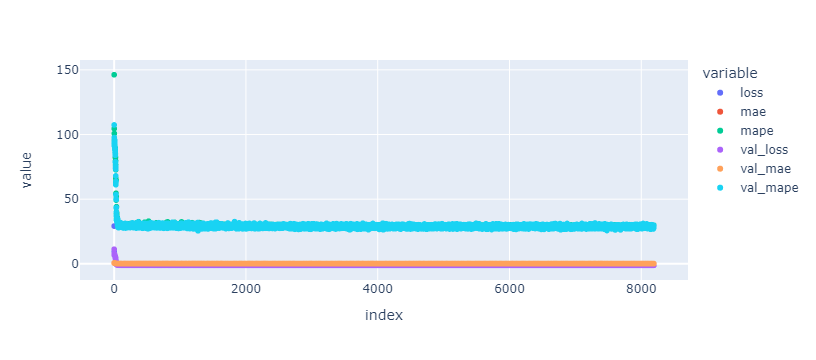

In [231]:
px.scatter(out.history)

In [232]:
negloglik = lambda x, rv_x: -rv_x.log_prob(x)

csd = tfk.experimental.CosineDecay(1e-3, 8192, alpha=1e-8)

model.compile(
    loss=negloglik,
    optimizer=tfko.Adam(1e-6),
    metrics=["mae", "mape"],
)

out = model.fit(ds, validation_data=vds, epochs=8192, verbose=False, shuffle=False) #callbacks=[LogEmbeddings()])

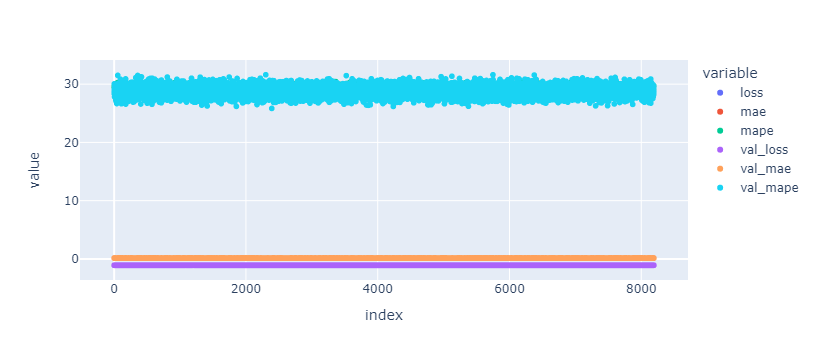

In [233]:
# Multiplication to ~ 22 MAPE
px.scatter(out.history)

In [234]:
negloglik = lambda x, rv_x: -rv_x.log_prob(x)

csd = tfk.experimental.CosineDecay(1e-4, 2048, alpha=1e-6)

model.compile(
    loss=negloglik,
    optimizer=tfko.Adam(csd),
    metrics=["mae", "mape"],
)

out = model.fit(ds, validation_data=vds, epochs=2048, verbose=False, shuffle=False) #callbacks=[LogEmbeddings()])

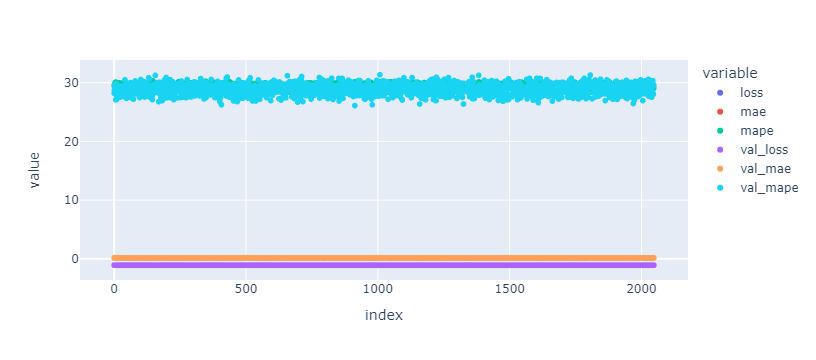

In [235]:
px.scatter(out.history)

In [132]:
# And done...
reduce_lr = tfk.callbacks.ReduceLROnPlateau(factor=0.1, patience=16, cooldown=16, min_delta=0.001, min_lr=1e-8)

model.compile(
    loss=negloglik,
    optimizer=tfko.Adam(1e-2),
    metrics=["mae", "mape"],
    
)

out = model.fit(ds, validation_data=vds, epochs=4096, verbose=True, shuffle=False, callbacks=reduce_lr) #callbacks=[LogEmbeddings()])

Epoch 1/4096
      1/Unknown - 3s 3s/step - loss: 16.7702 - mae: 0.5745 - mape: 92.3028WARNING:tensorflow:@custom_gradient grad_fn has 'variables' in signature, but no ResourceVariables were used on the forward pass.
2/2 [==============================] - 4s 1s/step - loss: 16.8343 - mae: 0.5790 - mape: 92.4367 - val_loss: 15.1674 - val_mae: 0.6346 - val_mape: 92.3518
Epoch 2/4096
2/2 [==============================] - 0s 53ms/step - loss: 13.7972 - mae: 0.5936 - mape: 89.5105 - val_loss: 13.3118 - val_mae: 0.6199 - val_mape: 88.9983
Epoch 3/4096
2/2 [==============================] - 0s 41ms/step - loss: 12.9110 - mae: 0.5900 - mape: 89.1100 - val_loss: 13.1305 - val_mae: 0.6168 - val_mape: 88.5379
Epoch 4/4096
2/2 [==============================] - 0s 39ms/step - loss: 12.2763 - mae: 0.5854 - mape: 87.3380 - val_loss: 12.0469 - val_mae: 0.6007 - val_mape: 82.2918
Epoch 5/4096
2/2 [==============================] - 0s 44ms/step - loss: 11.1554 - mae: 0.5559 - mape: 79.8674 - val_loss:

KeyboardInterrupt: 

In [ ]:
px.scatter(out.history)

## Historical training code

In [ ]:
negloglik = lambda x, rv_x: -rv_x.log_prob(x)

model.compile(
    loss=negloglik,
    optimizer=tfa.optimizers.Lookahead(tfko.Adam(1e-3)),
    metrics=["mae", "mape"],
)

out = model.fit(ds, validation_data=vds, epochs=2048, verbose=False, shuffle=True) #callbacks=[LogEmbeddings()])

In [ ]:
px.scatter(out.history)

In [ ]:
# # Set the intercepts to trainable 
#TrainableVars.trainable = False
model.compile(
    loss=negloglik,
    optimizer=tfa.optimizers.Lookahead(tfko.Adam(1e-4)),
    metrics=["mae", "mape"],
)

out = model.fit(ds, validation_data=vds, epochs=8192, verbose=True, shuffle=True, callbacks=[LogEmbeddings()])

In [ ]:
px.scatter(out.history)

In [ ]:
xs = [i[0] for i in list(gen())]
ys = [i[1] for i in list(gen())]
xs = model.predict([i[0] for i in list(gen())])

px.scatter(x=xs.flatten(), y=ys)

In [ ]:
model.compile(
    loss=negloglik,
    optimizer=tfa.optimizers.Lookahead(tfko.Adam(5e-5)),
    metrics=["mae", "mape"],
)

out = model.fit(ds, validation_data=vds, epochs=4096, verbose=False, shuffle=True, callbacks=[LogEmbeddings()])

In [ ]:
px.scatter(out.history)

In [ ]:
model.compile(
    loss=negloglik,
    optimizer=tfa.optimizers.Lookahead(tfko.Adam(1e-5)),
    metrics=["mae", "mape"],
)

out = model.fit(ds, validation_data=vds, epochs=4096, verbose=False, shuffle=True, callbacks=[LogEmbeddings()])

In [ ]:
px.scatter(out.history)

In [ ]:
TrainableVars.weights

In [ ]:
RipeRimu_Embeddings.weights

In [ ]:
csd = tfk.experimental.CosineDecay(1e-4, 8192)

model.compile(
    loss=negloglik,
    optimizer=tfa.optimizers.Lookahead(tfko.Adam(csd)),
    metrics=["mae", "mape"],
)

out = model.fit(ds, validation_data=vds, epochs=8192, verbose=False, shuffle=True)

In [ ]:
csd = tfk.experimental.CosineDecayRestarts(1e-3, 8192, alpha=1e-6)

model.compile(
    loss=negloglik,
    optimizer=tfa.optimizers.Lookahead(tfko.Adam(csd)),
    metrics=["mae", "mape"],
)

out = model.fit(ds, validation_data=vds, epochs=8192*12, verbose=False, shuffle=True)

In [ ]:
px.scatter(out.history)

In [ ]:
TrainableVars.weights

In [ ]:
Sex_Embeddings.weights

In [ ]:
Island_Embeddings.weights

In [ ]:
id_to_year

In [236]:
b0 = 0
b1 = 3
M = 6

v = b1

for_pandas = dict()
for_pandas["year"] = list()
for_pandas["val"] = list()

for k, year in id_to_year.items():
    loc = Year_Embeddings(k)[v].numpy()
    scale = Year_Embeddings(k)[v + 1].numpy()
    ndist = tfd.Normal(loc, scale)
    for _ in range(10000):
        for_pandas["year"].append(year)
        for_pandas["val"].append(ndist.sample().numpy())

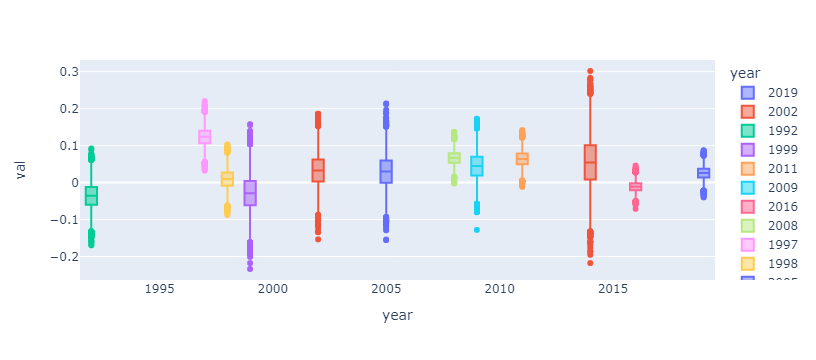

In [237]:
df = pd.DataFrame.from_dict(for_pandas, orient="columns")
px.box(df, x="year", y="val", color="year")

In [238]:
RipeRimu_Embeddings.weights

[<tf.Variable 'RipeRimuEmbeddings/embeddings:0' shape=(2, 9) dtype=float32, numpy=
 array([[-0.01520772,  0.00429742,  0.08356962, -0.02808909, -0.05288306,
         -0.01558318,  0.07093067, -0.04748042,  0.05717475],
        [ 0.02658377,  0.00043829, -0.00937583,  0.04014497, -0.00838194,
          0.08309639, -0.02975032,  0.04194813,  0.05184186]],
       dtype=float32)>]

In [239]:
testdata = next(iter(ds))
testdata[0][0]

<tf.Tensor: shape=(10,), dtype=float32, numpy=
array([ 0.     ,  5.     ,  1.     ,  1.     ,  6.     , 44.4375 ,
        0.     ,  3.     ,  2.     , 36.09039], dtype=float32)>

In [240]:
template = testdata[0][0][0:6]
template = template.numpy()
template

array([ 0.    ,  5.    ,  1.    ,  1.    ,  6.    , 44.4375],
      dtype=float32)

In [241]:
year_to_id

{2019: 0,
 2002: 1,
 1992: 2,
 1999: 3,
 2011: 4,
 2009: 5,
 2016: 6,
 2008: 7,
 1997: 8,
 1998: 9,
 2005: 10,
 2014: 11}

In [242]:
islandby_to_id

{'2019_Anchor': 0,
 '2019_Whenua Hou': 1,
 '2002_Whenua Hou': 2,
 '1992_Whenua Hou': 3,
 '1999_Hauturu': 4,
 '2011_Whenua Hou': 5,
 '2009_Whenua Hou': 6,
 '1999_Pearl': 7,
 '2016_Whenua Hou': 8,
 '2016_Anchor': 9,
 '2008_Whenua Hou': 10,
 '1997_Whenua Hou': 11,
 '1998_Maud': 12,
 '2005_Whenua Hou': 13,
 '2014_Hauturu': 14,
 '2014_Whenua Hou': 15}

In [243]:
# Template is:
# sex, year, layisland, handreared, islandby
template[0] = 0  # 0 Female, 1 Male
template[1] = 0  # 0 is 2019
template[2] = 0  # 0 is anchor, 1 is Whenua Hou
template[3] = 1  # 1 is handreared, 0 is Nested
template[4] = 1
# template[4] = 1
template

array([ 0.    ,  0.    ,  0.    ,  1.    ,  1.    , 44.4375],
      dtype=float32)

In [244]:
M = 6
b1 = 3
b0 = 0

v = b1

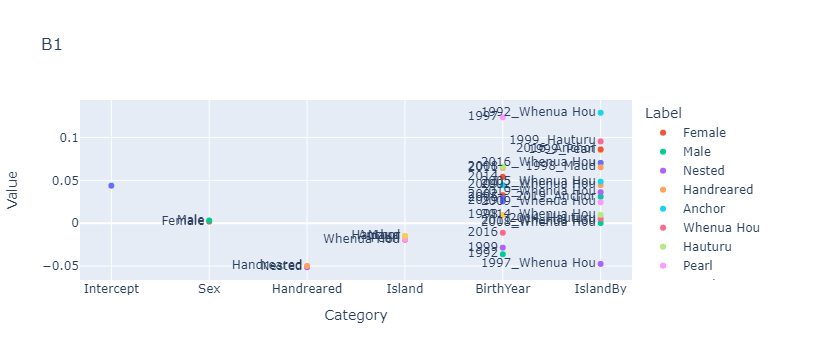

In [246]:
v = b1

titles = {M: "M", b0: "b0", b1: "B1"}

effects = list()

effects.append(["Intercept", TrainableVars.variables[0][v].numpy(), ""])

effects.append(["Sex", Sex_Embeddings(0)[v].numpy(), "Female"])
effects.append(["Sex", Sex_Embeddings(1)[v].numpy(), "Male"])

effects.append(["Handreared", Handreared_Embeddings(0)[v].numpy(), "Nested"])
effects.append(["Handreared", Handreared_Embeddings(1)[v].numpy(), "Handreared"])

#effects.append(["Ripe Rimu", RipeRimu_Embeddings(0)[v].numpy(), "Unripe"])
#effects.append(["Ripe Rimu", RipeRimu_Embeddings(1)[v].numpy(), "Ripe"])

for island, n in layisland_to_id.items():
    island_name = island

    effects.append(["Island", Island_Embeddings(n)[v].numpy(), island_name])

for year, n in year_to_id.items():
    effects.append(["BirthYear", Year_Embeddings(n)[v].numpy(), year])

for island, n in islandby_to_id.items():
    island_name = island

    effects.append(["IslandBy", Islandby_Embeddings(n)[v].numpy(), island_name])

effects = pd.DataFrame(effects, columns=["Category", "Value", "Label"])

fig = px.scatter(
    effects, x="Category", y="Value", color="Label", text="Label", title=titles[v]
)
fig.update_traces(textposition="middle left")

## Logistic Regression per bird using previous parameters

In [247]:
RipeRimu_Embeddings.weights

[<tf.Variable 'RipeRimuEmbeddings/embeddings:0' shape=(2, 9) dtype=float32, numpy=
 array([[-0.01520772,  0.00429742,  0.08356962, -0.02808909, -0.05288306,
         -0.01558318,  0.07093067, -0.04748042,  0.05717475],
        [ 0.02658377,  0.00043829, -0.00937583,  0.04014497, -0.00838194,
          0.08309639, -0.02975032,  0.04194813,  0.05184186]],
       dtype=float32)>]

In [248]:
weights["id"] = [bird_to_id[x] for x in weights["birdName"]]

In [249]:
# scale_dense = tfk.Sequential([
#    tfkl.Dense(2, kernel_initializer=init, bias_initializer=init),
#    tfp.layers.DistributionLambda(
#        make_distribution_fn=lambda i: tfd.Logistic(loc=i[..., 0], scale=1e-5 + 0.05 * tf.math.softplus(i[..., 1]))
#    )
# ], name="ScaleDense")

# scale_dense = tfk.Sequential([
#    tfkl.Dense(32, kernel_initializer=init, bias_initializer=init, activation="tanh"),
#    tfkl.Dense(128, kernel_initializer=init, bias_initializer=init, activation="tanh"),
#    tfkl.Dense(256, kernel_initializer=init, bias_initializer=init, activation="tanh"),
#    tfkl.Dense(64, kernel_initializer=init, bias_initializer=init, activation="tanh"),
#    tfkl.Dense(32, kernel_initializer=init, bias_initializer=init, activation="tanh"),
#    tfkl.Dense(1, kernel_initializer=init, bias_initializer=init, activation="tanh"),
# ], name="ScaleDense")

In [250]:
model.predict(np.asarray([next(iter(gen()))[0]]))

array([[0.02980638]], dtype=float32)

In [252]:
trainable = False
TrainableVars.trainable = trainable
Sex_Embeddings.trainable = trainable
Year_Embeddings.trainable = trainable
Island_Embeddings.trainable = trainable
Handreared_Embeddings.trainable = trainable
Islandby_Embeddings.trainable = trainable
RipeRimu_Embeddings.trainable = trainable
#NestMother_Embeddings.trainable = trainable
#HrRr_Embeddings.trainable = trainable

mask = np.random.rand(len(weights)) < 0.9
train = weights
# train = weights[mask]
test = weights[~mask]

batch_size = 256

init1 = tfk.initializers.RandomNormal(mean=0.05, stddev=0.02)


def gen():
    for _, data in weights.iterrows():
        s = 0
        if data["sex"] == "Male":
            s = 1
        yield (
            data["id"],
            s,
            year_to_id[data["birth_year"]],
            layisland_to_id[data["lay_island"]],
            data["handreared"],
            data["islandby"],
            data["age"],
            data["RipeRimu"],
            nestmother_to_id[data["nestMother"]],
            data["hr_rr_code"],
        ), data["weight"]


def vgen():
    for _, data in test.iterrows():
        s = 0
        if data["sex"] == "Male":
            s = 1
        yield (
            data["id"],
            s,
            year_to_id[data["birth_year"]],
            layisland_to_id[data["lay_island"]],
            data["handreared"],
            data["islandby"],
            data["age"],
            data["RipeRimu"],
            nestmother_to_id[data["nestMother"]],
            data["hr_rr_code"],
        ), data["weight"]


os = ((tf.TensorSpec(shape=(10))), tf.TensorSpec(shape=(), dtype=tf.float32))
ds = tf.data.Dataset.from_generator(gen, output_signature=os)
ds = ds.cache().repeat(6).shuffle(len(train)).batch(1024)

vds = tf.data.Dataset.from_generator(vgen, output_signature=os)
vds = vds.cache().repeat(6).shuffle(len(train)).batch(1024)

model_input = tfk.Input(shape=(10,), name="real_input")


# Inputs
age = model_input[..., 6]

# Layers
Chick_Embeddings = tfkl.Embedding(
    bird_count, output_dim=3 * 3, embeddings_initializer=init1
)

# Get the bird specific variables
chick_data = Chick_Embeddings(model_input[:, 0])
sex_data = Sex_Embeddings(model_input[:, 1])
year_data = Year_Embeddings(model_input[:, 2])
island_data = Island_Embeddings(model_input[:, 3])
handreared_data = Handreared_Embeddings(model_input[:, 4])
islandby_data = Islandby_Embeddings(model_input[:, 5])
riperimu_data = RipeRimu_Embeddings(model_input[:, 7])
# nestmother_data = NestMother_Embeddings(model_input[:, 8])
# hrrr_data = HrRr_Embeddings(model_input[:, 9])

tvs = TrainableVars(model_input)
tv_b0 = nd0(tvs[0:3])
tv_b1 = nd0(tvs[3:6])
tv_M  = nd0(tvs[6:9])

sex_b0 = nd1(sex_data[..., 0:3])
sex_b1 = nd1(sex_data[..., 3:6])
sex_M  = nd1(sex_data[..., 6:9])

year_b0 = nd1(year_data[..., 0:3])
year_b1 = nd1(year_data[..., 3:6])
year_M  = nd1(year_data[..., 6:9])

island_b0 = nd1(island_data[..., 0:3])
island_b1 = nd1(island_data[..., 3:6])
island_M  = nd1(island_data[..., 6:9])

islandby_b0 = nd1(islandby_data[..., 0:3])
islandby_b1 = nd1(islandby_data[..., 3:6])
islandby_M  = nd1(islandby_data[..., 6:9])

hr_b0 = nd1(handreared_data[..., 0:3])
hr_b1 = nd1(handreared_data[..., 3:6])
hr_M  = nd1(handreared_data[..., 6:9])

# Ripe Rimu
rr_b0 = nd1(riperimu_data[..., 0:3])
rr_b1 = nd1(riperimu_data[..., 3:6])
rr_M  = nd1(riperimu_data[..., 6:9])

chick_b0 = nd1(chick_data[..., 0:3])
chick_b1 = nd1(chick_data[..., 3:6])
chick_M  = nd1(chick_data[..., 6:9])

b0 = tv_b0 + sex_b0 + hr_b0 + year_b0 + island_b0 + islandby_b0 + chick_b0 # + rr_b0

b1 = sex_b1 + tv_b1 + hr_b1 + year_b1 + island_b1 + islandby_b1 + chick_b1 # rr_b1 

M = tv_M + sex_M + (
    hr_M + year_M + island_M + islandby_M + chick_M
) # + rr_M 

y = M * tf.math.exp(-tf.math.exp(b0 - (b1 * age)))  # So far the best

model = tfk.Model(inputs=[model_input], outputs=y)

In [253]:
chick_data = Chick_Embeddings(0)
chick_data

<tf.Tensor: shape=(9,), dtype=float32, numpy=
array([0.06487489, 0.07154921, 0.04832301, 0.08714403, 0.03590332,
       0.0516688 , 0.02250614, 0.05271193, 0.03364012], dtype=float32)>

In [254]:
# Chick_Embeddings.weights

In [255]:
csd = tfk.experimental.CosineDecay(1e-2, 8192, alpha=1e-6)


model.compile(
    loss=tf.losses.MeanAbsolutePercentageError(),
    #loss=negloglik,
    optimizer=tfa.optimizers.Lookahead(tfko.Adam(csd)),
    metrics=["mae"],
)
hist = model.fit(ds, epochs=8192, verbose=False, validation_data=vds, shuffle=True)


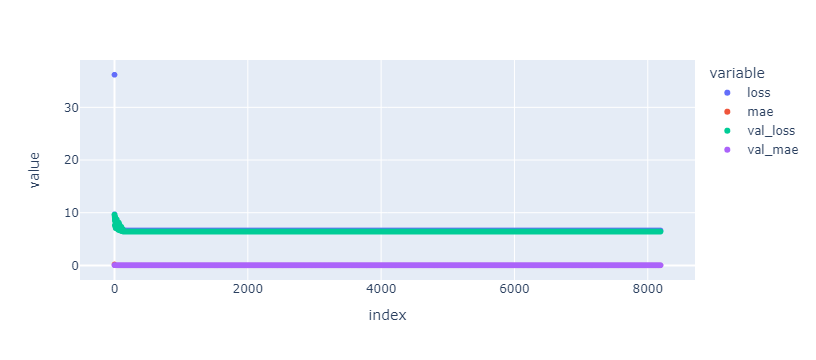

In [256]:
px.scatter(hist.history)

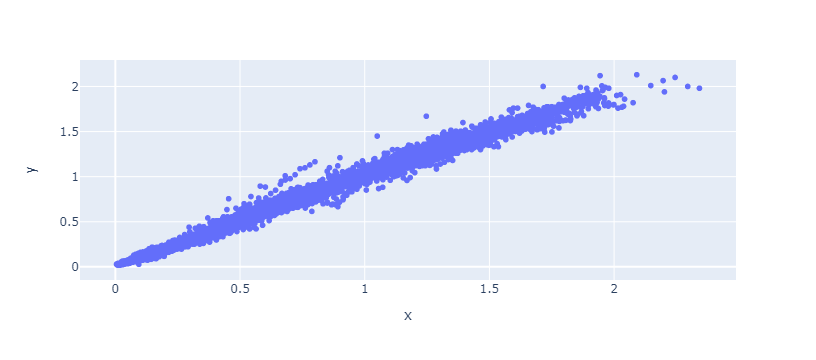

In [279]:
xs = [i[0] for i in list(gen())]
ys = [i[1] for i in list(gen())]
xs = model.predict([i[0] for i in list(gen())])

px.scatter(x=xs.flatten(), y=ys)

In [257]:
# Skipped

model.compile(
    loss=tf.losses.MeanAbsolutePercentageError(),
    # loss=negloglik,
    optimizer=tfko.Adam(1e-4),
    metrics=["mae"],
)
hist = model.fit(ds, epochs=1024, verbose=True, validation_data=vds, shuffle=True)
px.scatter(hist.history)

Epoch 1/1024
     15/Unknown - 5s 12ms/step - loss: 6.6594 - mae: 0.0277

KeyboardInterrupt: 

In [ ]:
model.compile(
    loss=tf.losses.MeanAbsolutePercentageError(),
    # loss=negloglik,
    optimizer=tfko.Adam(1e-5),
    metrics=["mae"],
)
hist = model.fit(ds, epochs=1024, verbose=True, validation_data=vds, shuffle=True)
px.scatter(hist.history)

In [ ]:
csd = tfk.experimental.CosineDecay(1e-4, 8192)

model.compile(
    loss=tf.losses.MeanAbsolutePercentageError(),
    # loss=negloglik,
    optimizer=tfko.Adam(csd),
    metrics=["mae"],
)
hist = model.fit(ds, epochs=8192, verbose=False, validation_data=vds, shuffle=True)
px.scatter(hist.history)

In [ ]:
Chick_Embeddings.weights

In [ ]:
Island_Embeddings.weights

In [273]:
def get_template_by_bird(name):
    for i in gen():
        if id_to_bird[i[0][0]] == name:
            return i[0]
    print(name + " Not found")

In [274]:
id_to_bird[3]

'Alf'

In [275]:
model.save_weights("chick_growth_final")

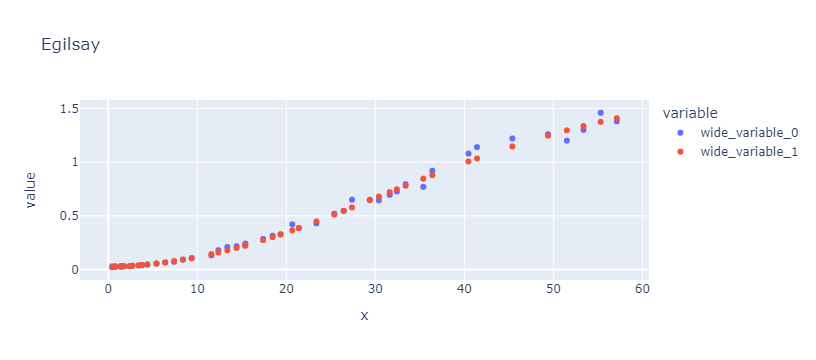

In [290]:
template = get_template_by_bird("Egilsay")

# Let's plot Aio|Sirocco|Clout (any bird, just change the name)
bird_name = id_to_bird[template[0]]

to_plot = list()

x = weights[weights["birdName"] == bird_name]["age"].to_list()

for z in x:
    d = np.copy(template)
    d[6] = z
    to_plot.append(d)

y_real = weights[weights["birdName"] == bird_name]["weight"].to_list()
y_pred = np.squeeze(model.predict(np.asarray(to_plot)))

px.scatter(x=x, y=[y_real, y_pred], title=bird_name)

In [260]:
chick_data = Chick_Embeddings(model_input[:, 0])
sex_data = Sex_Embeddings(model_input[:, 1])
year_data = Year_Embeddings(model_input[:, 2])
island_data = Island_Embeddings(model_input[:, 3])
handreared_data = Handreared_Embeddings(model_input[:, 4])
islandby_data = Islandby_Embeddings(model_input[:, 5])
riperimu_data = RipeRimu_Embeddings(model_input[:, 7])
#nestmother_data = NestMother_Embeddings(model_input[:, 8])
#hrrr_data = HrRr_Embeddings(model_input[:, 9])


In [261]:
np.save("chick_growth/Sex_embeddings.npy", Sex_Embeddings.weights[0].numpy())
np.save("chick_growth/Year_embeddings.npy", Year_Embeddings.weights[0].numpy())
np.save("chick_growth/Island_embeddings.npy", Island_Embeddings.weights[0].numpy())
np.save("chick_growth/Handreared_embeddings.npy", Handreared_Embeddings.weights[0].numpy())
np.save("chick_growth/Islandby_embeddings.npy", Islandby_Embeddings.weights[0].numpy())
np.save("chick_growth/RipeRimu_embeddings.npy", RipeRimu_Embeddings.weights[0].numpy())
#np.save("chick_growth/NestMother_embeddings.npy", NestMother_Embeddings.weights[0].numpy())
#np.save("chick_growth/HrRr_embeddings.npy", HrRr_Embeddings.weights[0].numpy())
np.save("chick_growth/Chick_embeddings.npy", Chick_Embeddings.weights[0].numpy())

Plot Individual Birds outside of the model

In [262]:
to_plot = np.asarray(to_plot)

NameError: name 'to_plot' is not defined

In [263]:
TrainableVars(True)

<tf.Tensor: shape=(13,), dtype=float32, numpy=
array([ 1.5102031 , -0.11515181,  0.18815066,  0.04381293, -0.22098947,
        0.12926692,  2.209775  , -0.17013961,  0.16434678,  0.11165978,
        0.10957686,  0.1061721 ,  0.19917396], dtype=float32)>

In [264]:
np.argmin(Chick_Embeddings.weights[0][:, 6])

22

In [ ]:
# This plots Alf 1000 times (sampling, rather than mean)

for i in range(1000):

    chick_data = Chick_Embeddings(to_plot[:, 0])
    sex_data = Sex_Embeddings(to_plot[:, 1])
    year_data = Year_Embeddings(to_plot[:, 2])
    island_data = Island_Embeddings(to_plot[:, 3])
    handreared_data = Handreared_Embeddings(to_plot[:, 4])
    islandby_data = Islandby_Embeddings(to_plot[:, 5])
    riperimu_data = RipeRimu_Embeddings(to_plot[:, 7])
    nestmother_data = NestMother_Embeddings(to_plot[:, 8])
    hrrr_data = HrRr_Embeddings(to_plot[:, 9])

    age = to_plot[..., 6]

    tvs = TrainableVars(True)
    tv_b0 = nd0(tvs[0:3])
    tv_b1 = nd0(tvs[3:6])
    tv_M  = nd0(tvs[6:9])

    sex_b0 = nd1(sex_data[..., 0:3])
    sex_b1 = nd1(sex_data[..., 3:6])
    sex_M  = nd1(sex_data[..., 6:9])

    year_b0 = nd1(year_data[..., 0:3])
    year_b1 = nd1(year_data[..., 3:6])
    year_M  = nd1(year_data[..., 6:9])

    island_b0 = nd1(island_data[..., 0:3])
    island_b1 = nd1(island_data[..., 3:6])
    island_M  = nd1(island_data[..., 6:9])

    islandby_b0 = nd1(islandby_data[..., 0:3])
    islandby_b1 = nd1(islandby_data[..., 3:6])
    islandby_M  = nd1(islandby_data[..., 6:9])

    hr_b0 = nd1(handreared_data[..., 0:3])
    hr_b1 = nd1(handreared_data[..., 3:6])
    hr_M  = nd1(handreared_data[..., 6:9])

    # Ripe Rimu
    rr_b0 = nd1(riperimu_data[..., 0:3])
    rr_b1 = nd1(riperimu_data[..., 3:6])
    rr_M  = nd1(riperimu_data[..., 6:9])

    chick_b0 = nd1(chick_data[..., 0:3])
    chick_b1 = nd1(chick_data[..., 3:6])
    chick_M  = nd1(chick_data[..., 6:9])
    
    b0 = (
        tv_b0.mean() + sex_b0.mean() + (hr_b0.mean() + year_b0.mean() + island_b0.mean() + islandby_b0.mean() + rr_b0.mean()) + chick_b0.sample()
    )  

    b1 = rr_b1.mean() + (
        sex_b1.mean() + tv_b1.mean() + hr_b1.mean() + year_b1.mean() + island_b1.mean() + islandby_b1.mean() + chick_b1.sample()
    )

    M = tv_M.mean() + sex_M.mean() * (
        hr_M.mean() + year_M.mean() + island_M.mean() + islandby_M.mean() + rr_M.mean() + chick_M.sample()
    )

    y = M * tf.math.exp(-tf.math.exp(b0 - (b1 * age)))  # So far the best
    y_pred = y.numpy()
    
    fig = px.scatter(x=x, y=[y_real, y_pred], title="Alf Environment @ Mean, Chick @ 1000 Samples")
    fig.update_layout(showlegend=False)
    fig.update_layout(yaxis_range=[0.,2.5])

    fig.write_image("growth_curve_animation/" + str(i) + ".jpeg")

In [ ]:
# This plots all chicks vs. Alf

for i in range(157):

    chick_data = Chick_Embeddings(to_plot[:, 0])
    sex_data = Sex_Embeddings(to_plot[:, 1])
    year_data = Year_Embeddings(to_plot[:, 2])
    island_data = Island_Embeddings(to_plot[:, 3])
    handreared_data = Handreared_Embeddings(to_plot[:, 4])
    islandby_data = Islandby_Embeddings(to_plot[:, 5])
    riperimu_data = RipeRimu_Embeddings(to_plot[:, 7])
    nestmother_data = NestMother_Embeddings(to_plot[:, 8])
    hrrr_data = HrRr_Embeddings(to_plot[:, 9])

    # Replacement line
    chick_data = Chick_Embeddings(i)

    age = to_plot[..., 6]

    tvs = TrainableVars(True)
    tv_b0 = nd0(tvs[0:3])
    tv_b1 = nd0(tvs[3:6])
    tv_M  = nd0(tvs[6:9])

    sex_b0 = nd1(sex_data[..., 0:3])
    sex_b1 = nd1(sex_data[..., 3:6])
    sex_M  = nd1(sex_data[..., 6:9])

    year_b0 = nd1(year_data[..., 0:3])
    year_b1 = nd1(year_data[..., 3:6])
    year_M  = nd1(year_data[..., 6:9])

    island_b0 = nd1(island_data[..., 0:3])
    island_b1 = nd1(island_data[..., 3:6])
    island_M  = nd1(island_data[..., 6:9])

    islandby_b0 = nd1(islandby_data[..., 0:3])
    islandby_b1 = nd1(islandby_data[..., 3:6])
    islandby_M  = nd1(islandby_data[..., 6:9])

    hr_b0 = nd1(handreared_data[..., 0:3])
    hr_b1 = nd1(handreared_data[..., 3:6])
    hr_M  = nd1(handreared_data[..., 6:9])

    # Ripe Rimu
    rr_b0 = nd1(riperimu_data[..., 0:3])
    rr_b1 = nd1(riperimu_data[..., 3:6])
    rr_M  = nd1(riperimu_data[..., 6:9])

    chick_b0 = nd1(chick_data[..., 0:3])
    chick_b1 = nd1(chick_data[..., 3:6])
    chick_M  = nd1(chick_data[..., 6:9])
    
    b0 = (
        tv_b0.mean() + sex_b0.mean() + (hr_b0.mean() + year_b0.mean() + island_b0.mean() + islandby_b0.mean() + rr_b0.mean()) + chick_b0.mean()
    )  

    b1 = rr_b1.mean() + (
        sex_b1.mean() + tv_b1.mean() + hr_b1.mean() + year_b1.mean() + island_b1.mean() + islandby_b1.mean() + chick_b1.mean()
    )

    M = tv_M.mean() + sex_M.mean() * (
        hr_M.mean() + year_M.mean() + island_M.mean() + islandby_M.mean() + rr_M.mean() + chick_M.mean()
    )

    y = M * tf.math.exp(-tf.math.exp(b0 - (b1 * age)))  # So far the best
    y_pred = y.numpy()
    
    fig = px.scatter(x=x, y=[y_real, y_pred], title="Alf as Baseline (Means of Chicks + Environment)")
    fig.update_layout(showlegend=False)
    fig.update_layout(yaxis_range=[0.,2.5])

    fig.write_image("growth_curve_animation/" + str(i) + ".jpeg")

In [ ]:
to_plot = np.asarray([to_plot[-1]])

In [ ]:
# Calculate how much each change in M relates to 60 day weight

# This plots all chicks vs. Alf

ms = list()
weight60d = list()

for i in range(157):

    chick_data = Chick_Embeddings(to_plot[:, 0])
    sex_data = Sex_Embeddings(to_plot[:, 1])
    year_data = Year_Embeddings(to_plot[:, 2])
    island_data = Island_Embeddings(to_plot[:, 3])
    handreared_data = Handreared_Embeddings(to_plot[:, 4])
    islandby_data = Islandby_Embeddings(to_plot[:, 5])
    riperimu_data = RipeRimu_Embeddings(to_plot[:, 7])
    nestmother_data = NestMother_Embeddings(to_plot[:, 8])
    hrrr_data = HrRr_Embeddings(to_plot[:, 9])

    # Replacement line
    chick_data = Chick_Embeddings(i)

    age = to_plot[..., 6]

    tvs = TrainableVars(True)
    tv_b0 = nd0(tvs[0:3])
    tv_b1 = nd0(tvs[3:6])
    tv_M  = nd0(tvs[6:9])

    sex_b0 = nd1(sex_data[..., 0:3])
    sex_b1 = nd1(sex_data[..., 3:6])
    sex_M  = nd1(sex_data[..., 6:9])

    year_b0 = nd1(year_data[..., 0:3])
    year_b1 = nd1(year_data[..., 3:6])
    year_M  = nd1(year_data[..., 6:9])

    island_b0 = nd1(island_data[..., 0:3])
    island_b1 = nd1(island_data[..., 3:6])
    island_M  = nd1(island_data[..., 6:9])

    islandby_b0 = nd1(islandby_data[..., 0:3])
    islandby_b1 = nd1(islandby_data[..., 3:6])
    islandby_M  = nd1(islandby_data[..., 6:9])

    hr_b0 = nd1(handreared_data[..., 0:3])
    hr_b1 = nd1(handreared_data[..., 3:6])
    hr_M  = nd1(handreared_data[..., 6:9])

    # Ripe Rimu
    rr_b0 = nd1(riperimu_data[..., 0:3])
    rr_b1 = nd1(riperimu_data[..., 3:6])
    rr_M  = nd1(riperimu_data[..., 6:9])

    chick_b0 = nd1(chick_data[..., 0:3])
    chick_b1 = nd1(chick_data[..., 3:6])
    chick_M  = nd1(chick_data[..., 6:9])
    
    b0 = (
        tv_b0.mean() + sex_b0.mean() + (hr_b0.mean() + year_b0.mean() + island_b0.mean() + islandby_b0.mean() + rr_b0.mean()) + chick_b0.mean()
    )  

    b1 = rr_b1.mean() + (
        sex_b1.mean() + tv_b1.mean() + hr_b1.mean() + year_b1.mean() + island_b1.mean() + islandby_b1.mean() + chick_b1.mean()
    )

    M = tv_M.mean() + sex_M.mean() * (
        hr_M.mean() + year_M.mean() + island_M.mean() + islandby_M.mean() + rr_M.mean() + chick_M.mean()
    )
    
    y = M * tf.math.exp(-tf.math.exp(b0 - (b1 * age)))  # So far the best
    y_pred = y.numpy()
    ms.append(chick_M.mean().numpy())
    weight60d.append(y_pred[0])

In [ ]:
px.scatter(x=ms, y=weight60d)

In [ ]:
np.corrcoef(ms, weight60d)

In [ ]:
m, b = np.polyfit(ms, weight60d, 1)
[m, b]

In [ ]:
x = -6
y = m * x
y

In [ ]:
b0 = (
    tv_b0.sample() + sex_b0.sample() + (hr_b0.sample() + year_b0.sample() + island_b0.sample() + islandby_b0.sample() + rr_b0.sample()) + chick_b0.sample()
)  

b1 = rr_b1.sample() + (
    sex_b1.sample() + tv_b1.sample() + hr_b1.sample() + year_b1.sample() + island_b1.sample() + islandby_b1.sample() + chick_b1.sample()
)

M = tv_M.sample() + sex_M.sample() * (
    hr_M.sample() + year_M.sample() + island_M.sample() + islandby_M.sample() + rr_M.sample() + chick_M.sample()
)

y = M * tf.math.exp(-tf.math.exp(b0 - (b1 * age)))  # So far the best
y_pred = y.numpy()

In [ ]:
fig = px.scatter(x=x, y=[y_real, y_pred], title=bird_name)
fig

In [ ]:
# Chick_Embeddings.weights[0][179]

In [280]:
# bird_to_id

# Means
output = pd.DataFrame(
    {
        "Taxa": bird_to_id.keys(),
        "b0": Chick_Embeddings.weights[0][:, 0].numpy(),
        "b1": Chick_Embeddings.weights[0][:, 3].numpy(),
        "M": Chick_Embeddings.weights[0][:, 6].numpy(),
    }
)

In [281]:
Chick_Embeddings.weights[0][:, 6].numpy()

array([-0.38508645, -0.6515262 , -0.3803198 ,  0.00417615,  0.22571546,
        0.04912731, -0.25754774,  0.35074306,  0.01283032, -0.908585  ,
       -0.11087339,  0.00908037, -0.07062458,  0.2779653 , -0.04945995,
       -0.45074898,  0.11192742, -0.5279096 , -0.9101783 ,  0.29240432,
       -0.5246935 , -0.10289426, -1.6691989 , -0.23307423, -0.0335673 ,
        0.01849384, -0.13027152, -0.23540545,  1.0759344 , -0.20096307,
        0.72481894, -0.28763643,  0.53254586, -0.5367804 , -0.22333784,
       -0.4340953 , -0.3215814 ,  0.07820641, -0.18944475,  0.23746683,
       -0.07825066, -0.51922077, -0.1127014 , -0.20907223, -0.11162596,
        0.07251506, -0.10801907, -0.43652192,  0.51721585, -0.57485473,
        0.27666414, -0.36085525, -0.48457798, -0.16854912,  1.034963  ,
        0.08859774,  0.00619018, -0.44053856, -1.1517491 , -0.20617089,
       -0.16770007, -0.09009226,  0.48878157,  0.25872824,  0.00633216,
       -0.02414572,  0.28640044, -0.32531294, -0.48664725, -0.87

In [282]:
birds_trained = set(weights["birdName"].unique())
for i, r in output.iterrows():
    if r["Taxa"] not in birds_trained:
        output.drop(output[output["Taxa"] == r["Taxa"]].index, inplace=True)

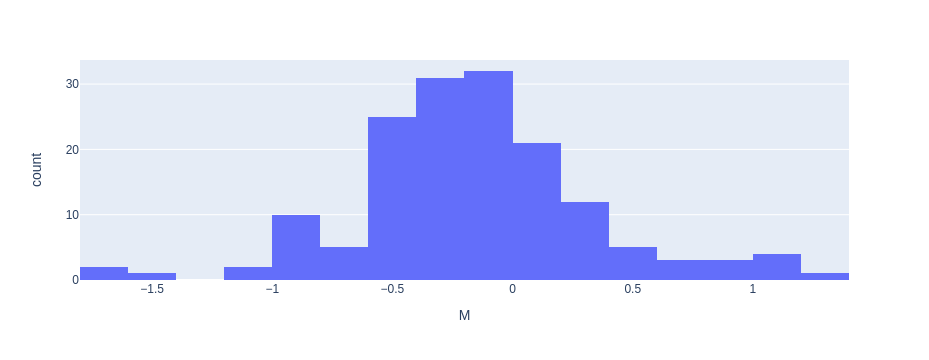

In [283]:
px.histogram(output, x="M")

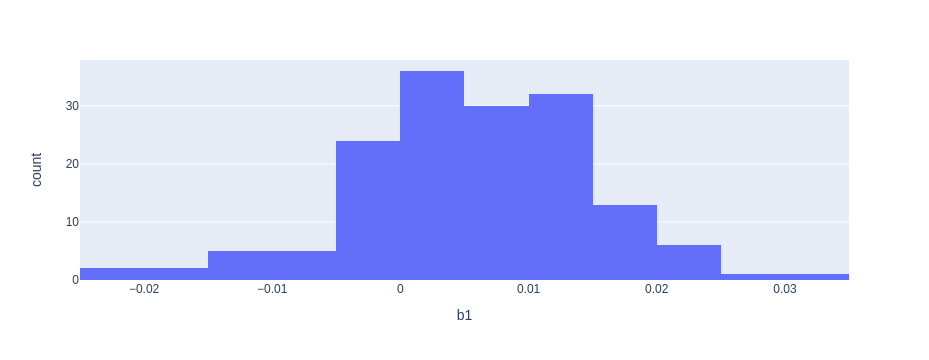

In [284]:
px.histogram(output, x="b1")

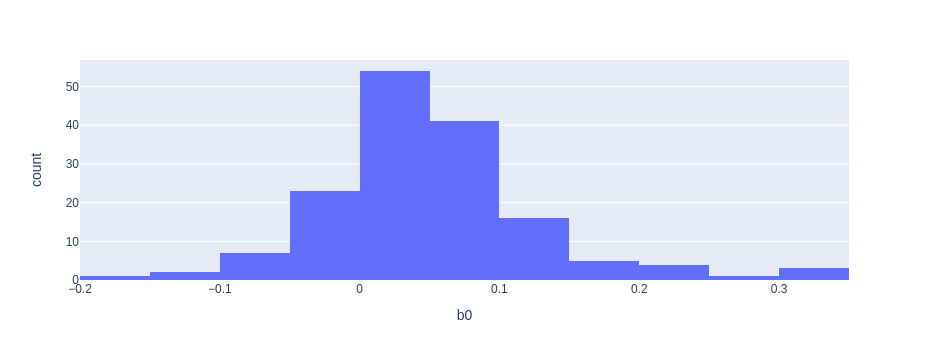

In [285]:
px.histogram(output, x="b0")

In [ ]:
Ms = Chick_Embeddings.weights[0][:, 6].numpy()
np.where(Ms <= np.mean(Ms) + 4 * np.std(Ms))


In [289]:
id_to_bird[22]

'Egilsay'

In [ ]:
weights[weights['birdName'] == 'Big_Nick']

In [288]:
np.argmin(output['M'])

22

for j in output[output['b1'] > 0.8].index:
    print(id_to_bird[j])

output.drop(output[output["M"] < -1.5].index, inplace=True)
output.drop(output[output["M"] > 1].index, inplace=True)
output.drop(output[output["b0"] > 1].index, inplace=True)
output.drop(output[output["b0"] < 0].index, inplace=True)
#output.drop(output[output["b1"] > 1].index, inplace=True)
output.drop(output[output["b1"] < 1].index, inplace=True)
output

In [270]:
output.to_csv("weights.txt", index=False, sep="\t")

#output.insert(0, "FID", "0")
#output.to_csv(
#    "/home/josephguhlin/software/gcta_1.93.2beta/weights.txt",
#    index=False,
#    sep="\t",
#    header=False,
#)

In [ ]:
output

In [ ]:
# Chick_Embeddings.weights[0][:, 2]

In [ ]:
# Negative correlation

# px.scatter(x=Chick_Embeddings.weights[0][:, 1], y=Chick_Embeddings.weights[0][:, 2], text=output['Taxa'])
px.scatter(output, x="M", y="b1", text="Taxa")

In [ ]:
output["b1"]

In [ ]:
np.corrcoef(output["M"], output["b1"])

# Fit linear regression

In [ ]:
y = output["b1"]
x = output["M"]
x_range = [-1.5, 2.5]
x_tst = np.linspace(*x_range, num=100).astype(np.float32)
x_tst = x_tst[..., np.newaxis]

model = tf.keras.Sequential(
    [
        tf.keras.layers.Dense(1 + 1),
        tfp.layers.DistributionLambda(
            lambda t: tfd.Laplace(
                loc=t[..., :1], scale=1e-5 + tf.math.softplus(0.05 * t[..., 1:])
            )
        ),
    ]
)

model.compile(optimizer=tf.optimizers.Adam(learning_rate=0.01), loss=negloglik)
loss0 = model.fit(x, y, epochs=1000, verbose=False)

model.compile(optimizer=tf.optimizers.Adam(learning_rate=0.001), loss=negloglik)
loss1 = model.fit(x, y, epochs=1000, verbose=False)

model.compile(optimizer=tf.optimizers.Adam(learning_rate=0.0001), loss=negloglik)
loss2 = model.fit(x, y, epochs=1000, verbose=False)

[print(np.squeeze(w.numpy())) for w in model.weights]
yhat = model(x_tst)
[loss0.history["loss"][-1], loss1.history["loss"][-1], loss2.history["loss"][-1]]

In [ ]:
m = yhat.mean().numpy().flatten()
s = yhat.stddev().numpy().flatten()
[m.mean(), s.mean()]

In [ ]:
import plotly.graph_objects as go

fig = go.Figure(go.Scatter(x=x_tst.flatten(), y=m))
fig.add_trace(go.Scatter(x=x_tst.flatten(), y=m + 2 * s))
fig.add_trace(go.Scatter(x=x_tst.flatten(), y=m - 2 * s))
fig.add_trace(go.Scatter(x=output["M"], y=output["b1"], mode="markers", name="Data"))
fig

In [ ]:
output["b1_norm"] = b1  # Derived BELOW
px.scatter(output, x="M", y="b1_norm", text="Taxa")

In [ ]:
np.corrcoef(output["M"], output["b1_norm"])

In [ ]:
px.histogram(output["b1_norm"])

In [ ]:
output.to_csv("weights.txt", index=False, sep="\t")

output.insert(0, "FID", "0")
output.to_csv(
    "/home/josephguhlin/software/gcta_1.93.2beta/weights.txt",
    index=False,
    sep="\t",
    header=False,
)

In [ ]:
output

In [ ]:
weights["birdName"].unique()

In [ ]:
px.scatter(x=output["M"], y=output["b1"])

In [ ]:
b1 = output["b1"]
M = output["M"]

b1 = b1 + abs(b1.min())
b1 = b1 / b1.max()

M = M + abs(M.min())
M = M / M.max()

[b1.min(), b1.max(), M.min(), M.max()]

In [ ]:
y = b1
x = M
x_range = [0.0, 1.0]
x_tst = np.linspace(*x_range, num=100).astype(np.float32)
x_tst = x_tst[..., np.newaxis]

model = tf.keras.Sequential(
    [
        tf.keras.layers.Dense(1 + 1),
        tfp.layers.DistributionLambda(
            lambda t: tfd.Laplace(
                loc=t[..., :1], scale=1e-5 + tf.math.softplus(0.05 * t[..., 1:])
            )
        ),
    ]
)

model.compile(optimizer=tf.optimizers.Adam(learning_rate=0.01), loss=negloglik)
loss0 = model.fit(x, y, epochs=1000, verbose=False)

model.compile(optimizer=tf.optimizers.Adam(learning_rate=0.001), loss=negloglik)
loss1 = model.fit(x, y, epochs=1000, verbose=False)

model.compile(optimizer=tf.optimizers.Adam(learning_rate=0.0001), loss=negloglik)
loss2 = model.fit(x, y, epochs=1000, verbose=False)

[print(np.squeeze(w.numpy())) for w in model.weights]
yhat = model(x_tst)
[loss0.history["loss"][-1], loss1.history["loss"][-1], loss2.history["loss"][-1]]

In [ ]:
m = yhat.mean().numpy().flatten()
s = yhat.stddev().numpy().flatten()
[m.mean(), s.mean()]

In [ ]:
import plotly.graph_objects as go

fig = go.Figure(go.Scatter(x=x_tst.flatten(), y=m))
fig.add_trace(go.Scatter(x=x_tst.flatten(), y=m + 2 * s))
fig.add_trace(go.Scatter(x=x_tst.flatten(), y=m - 2 * s))
fig.add_trace(go.Scatter(x=M, y=b1, mode="markers", name="Data"))
fig

In [ ]:
M = M.to_numpy()
M = M[..., np.newaxis]
dist = model(M)

In [ ]:
corr = dist.mean().numpy().flatten()

In [ ]:
b1 = b1.to_numpy().flatten() - corr
px.scatter(x=M.flatten(), y=b1)

## Logistic Regression per bird

In [ ]:
init = tfk.initializers.RandomNormal(mean=0.5, stddev=0.05)

loc0 = tf.Variable(2.5, name="FIRST_loc")
scale0 = tf.Variable(0.5, name="FIRST_scale")
Mdist = tfp.distributions.Normal(loc=loc0, scale=scale0)

model_input = tfk.Input(shape=(3,), name="input")
# Inputs
time = model_input[:, 1]
M = model_input[:, 2]

# Layers
Data_Embeddings = tfkl.Embedding(bird_count, output_dim=3, embeddings_initializer=init)

# Get the bird specific variables
data = Data_Embeddings(model_input[:, 0])
b0 = data[:, 0]
b1 = data[:, 1]
M = data[:, 2]

y_lower = 1 + tf.math.exp(-1 * (b0 + (b1 * time)))
# y = Mdist.sample() * (1/y_lower)
y = M * (1 / y_lower)
# y = (1/y_lower)


model = tfk.Model(inputs=[model_input], outputs=y)

model.summary()

In [ ]:
# Let's plot Aio|Sirocco|Clout (any bird, just change the name)
bird_name = "Clout"

Ms = weights.groupby(by="birdName")["weight"].max()
Mins = weights.groupby(by="birdName")["weight"].min()

x = weights[weights["birdName"] == bird_name]["age"].to_list()
y_real = weights[weights["birdName"] == bird_name]["weight"].to_list()
y_pred = np.squeeze(
    model.predict([[bird_to_id[bird_name], z, Ms[bird_name]] for z in x])
)

px.scatter(x=x, y=[y_real, y_pred])

In [ ]:
model.compile(
    loss=tf.losses.MeanAbsoluteError(),
    # loss=negloglik,
    optimizer=tfko.Adam(1e-2),
    metrics=["mae", "mse"],
)
model.fit(ds, epochs=64, verbose=False)
# print("One")

# model.compile(
#    loss=tf.losses.MeanAbsoluteError(),
#    optimizer=tfko.Adam(1e-4),
#    metrics=["mae", "mse"]
# )
# model.fit(ds, epochs=64, verbose=False)
# print("Two")

# model.compile(
#    loss=tf.losses.MeanAbsoluteError(),
#    optimizer=tfko.Adam(1e-5),
#    metrics=["mae", "mse"]
# )
# out = model.fit(ds, epochs=32, verbose=False)
print(out.history)

In [ ]:
px.scatter(out.history)

In [ ]:
# Let's plot Aio|Sirocco|Clout (any bird, just change the name)
# bird_name = "F2-2002"
bird_name = "Paddy"
x = weights[weights["birdName"] == bird_name]["age"].to_list()
y_real = weights[weights["birdName"] == bird_name]["weight"].to_list()
y_pred = np.squeeze(
    model.predict([[bird_to_id[bird_name], z, Ms[bird_name]] for z in x])
)

px.line(
    x=x,
    y=[y_real, y_pred],
    title=bird_name,
    labels={"wide_variable_0": "Real", "wide_variable_1": "Logistic"},
)

In [271]:
# Let's plot Aio|Sirocco|Clout (any bird, just change the name)
bird_name = "Sirocco"
# bird_name = "Ruggedy"
x = weights[weights["birdName"] == bird_name]["age"].to_list()
y_real = weights[weights["birdName"] == bird_name]["weight"].to_list()
y_pred = np.squeeze(
    model.predict([[bird_to_id[bird_name], z, Ms[bird_name]] for z in x])
)

px.line(
    x=x,
    y=[y_real, y_pred],
    title=bird_name,
    labels={"wide_variable_0": "Real", "wide_variable_1": "Logistic"},
)

NameError: name 'Ms' is not defined

In [ ]:
x = weights[weights["birdName"] == bird_name]["age"].to_list()
y_real = weights[weights["birdName"] == bird_name]["weight"].to_list()
y_pred = np.squeeze(
    model.predict([[bird_to_id[bird_name], z, Ms[bird_name]] for z in x])
)

px.scatter(
    x=x,
    y=[y_real, y_pred],
    title=bird_name,
    labels={"wide_variable_0": "Real", "wide_variable_1": "Logistic"},
)

In [ ]:
Data_Embeddings.variables

In [ ]:
import scipy.stats as stats
import statsmodels.api as sm
from bioinfokit.analys import stat
from statsmodels.formula.api import ols

In [ ]:
birth_years = dict()

for i in weights[["birdName", "dateHatched"]].iterrows():
    birth_years[i[1]["birdName"]] = i[1]["dateHatched"][0:4]

In [ ]:
birth_island = dict()

for i in weights[["birdName", "island"]].iterrows():
    if i[1]["birdName"] not in birth_island:
        birth_island[i[1]["birdName"]] = i[1]["island"]

In [ ]:
ascent = Chick_Embeddings.variables[0].numpy()

Ms = weights.groupby(by="birdName")["weight"].max()
Mins = weights.groupby(by="birdName")["weight"].min()

data = list()
for x in birth_years.keys():
    # We have some missing data right now :(
    if x in sex:
        data.append(
            {
                "bird": x,
                "birth_year": birth_years[x],
                "birth_island": birth_island[x],
                "b0": ascent[bird_to_id[x]][0],
                "b1": ascent[bird_to_id[x]][1],
                "M": ascent[bird_to_id[x]][2],
                "max_weight": Ms[x],
                "min_weight": Mins[x],
                "sex": sex[x],
                "nestMother": nestMother[x],
                "eggLength": eggLength[x],
                "eggWeight": eggWeight[x],
                "eggWidth": eggWidth[x],
            }
        )
# data

In [ ]:
weights

In [ ]:
res = stat()
res.anova_stat(
    df=weights,
    res_var="weight",
    anova_model="weight ~ age*C(sex) + C(birth_year) + C(lay_island) + C(island) + C(handreared) + C(island_by_year)",
    ss_typ=3,
)
res.anova_summary

In [ ]:
for x in birth_years.keys():
    if x not in sex:
        print("{}".format(x))

## Anova

In [ ]:
data = pd.DataFrame(data)
data["birth_year"] = data["birth_year"].astype(int)
data["birth_island"] = data["birth_island"].astype("category")
data

In [ ]:
data.keys()

In [ ]:
res = stat()
res.anova_stat(
    df=data,
    res_var="max_weight",
    anova_model="max_weight ~ C(birth_year) + C(birth_island) + C(birth_year):C(birth_island) + b0 + b1 + b0:b1 + min_weight + C(nestMother) + eggLength + eggWeight + eggWidth + C(sex)",
    ss_typ=3,
)
res.anova_summary

In [ ]:
res = stat()
res.anova_stat(
    df=data,
    res_var="b1",
    anova_model="b1 ~ age + C(birth_year) + C(birth_island) + C(birth_year):C(birth_island) + max_weight + b0 + min_weight + min_weight:max_weight + C(nestMother) + eggLength + eggWeight + eggWidth + C(sex) + M",
    ss_typ=3,
)
res.anova_summary

In [ ]:
res = stat()
res.anova_stat(
    df=data,
    res_var="b0",
    anova_model="b0 ~ age + C(birth_year) + C(birth_island) + C(birth_year):C(birth_island) + max_weight + min_weight + min_weight:max_weight + C(nestMother) + eggLength + eggWeight + eggWidth + C(sex) + M",
    ss_typ=3,
)
res.anova_summary

In [ ]:
res = stat()
res.anova_stat(
    df=data,
    res_var="M",
    anova_model="M ~ C(birth_year) + C(birth_island) + C(birth_year):C(birth_island) + max_weight + min_weight + min_weight:max_weight + C(nestMother) + eggLength + eggWeight + eggWidth + C(sex) + b0 + b1 + b0:b1",
    ss_typ=3,
)
res.anova_summary

In [ ]:
res = stat()
res.anova_stat(
    df=data,
    res_var="b1",
    anova_model="b1 ~ C(birth_year) + C(birth_island) + C(birth_year):C(birth_island) + b0",
    ss_typ=3,
)
res.anova_summary

In [ ]:
res = stat()
res.anova_stat(
    df=data,
    res_var="min_weight",
    anova_model="min_weight ~ C(birth_year) + C(birth_island) + C(birth_year):C(birth_island) + max_weight + b0 + b1 + b0:b1",
    ss_typ=3,
)
res.anova_summary

In [ ]:
px.scatter(data, x="b0", y="b1")

In [ ]:
px.box(data, x="birth_year", y="b0")

In [ ]:
px.box(data, x="birth_year", y="b1")

In [ ]:
px.box(data, x="birth_island", y="b0")

In [ ]:
px.box(data, x="sex", y="max_weight")

In [ ]:
px.box(data, x="sex", y="b0")

In [ ]:
px.box(data, x="sex", y="b1")

In [ ]:
px.box(data, x="sex", y="M")

In [ ]:
px.histogram(data, x="b1")

In [ ]:
data[data["b1"] < 0.09]

In [ ]:
data[["bird", "b0", "b1", "M"]].to_csv("b0_b1_phenos.tsv", sep="\t", index=False)

## In-progress models

$ y= M(1-e^{-ax}) $

y is the weight at time x
a is the speed of the plateau function
M is the maximum of the plateau

In [ ]:
init = tfk.initializers.RandomNormal(mean=0.5, stddev=0.05)

model_input = tfk.Input(shape=(3,), name="input")
time = model_input[:, 1]

Data_Embeddings = tfkl.Embedding(bird_count, output_dim=4, embeddings_initializer=init)

data = Data_Embeddings(model_input[:, 0])
# a = data[:, 0]
# b = data[:, 1]
# M = data[:, 1]
M = model_input[:, 2]
time = tf.expand_dims(time, 1)
x = tf.concat([data, time], axis=-1)

# y = M * (1-tf.math.exp(-(a * time)))
# y = y - b
d0 = tfkl.Dense(16, activation="relu", use_bias=False)
d1 = tfkl.Dense(16, activation="relu", use_bias=False)
d_out = tfkl.Dense(1, activation="linear", use_bias=False)

y = d_out(d1(d0(x)))

model = tfk.Model(inputs=[model_input], outputs=y)

model.summary()

In [ ]:
# Let's plot Aio|Sirocco (any bird, just change the name)
bird_name = "Aio"
x = weights[weights["birdName"] == bird_name]["age"].to_list()
y_real = weights[weights["birdName"] == bird_name]["weight"].to_list()
y_pred = np.squeeze(
    model.predict([[bird_to_id[bird_name], z, Ms[bird_name]] for z in x])
)

px.scatter(x=x, y=[y_real, y_pred])

In [ ]:
model.compile(
    loss=tf.losses.MeanAbsoluteError(),
    optimizer=tfko.Adam(1e-2),
    metrics=["mae", "mse"],
)
model.fit(ds, epochs=64)

In [ ]:
model.compile(
    loss=tf.losses.MeanAbsoluteError(),
    optimizer=tfko.Adam(1e-3),
    metrics=["mae", "mse"],
)
model.fit(ds, epochs=16)

In [ ]:
model.compile(
    loss=tf.losses.MeanAbsoluteError(),
    optimizer=tfko.Adam(1e-4),
    metrics=["mae", "mse"],
)
model.fit(ds, epochs=64)

In [ ]:
ds = tfd.Dataset.from_generator(gen, output_signature=os)
ds = ds.cache().shuffle(17115).batch(8192)
model.fit(ds, epochs=128)

In [ ]:
Data_Embeddings.variables

In [ ]:
ascent = Data_Embeddings.variables[0].numpy()
px.box(ascent, labels=list(range(len(ascent))))

In [ ]:
weights

## Which birds have abnormally high ascent values?
Was used previously, more filtering steps above, and now it is none. Leaving as just a sanity check

In [ ]:
birds = np.where(np.any(ascent > 0.05, axis=1))

for i in birds[0]:
    r = weights[weights["id"] == i]["birdName"]
    print(len(r))

In [ ]:
# Highest weight value, M used in formula above
Ms = weights.groupby(by="birdName")["weight"].max()

In [ ]:
# Let's plot Aio|Sirocco (any bird, just change the name)
bird_name = "Sirocco"
x = weights[weights["birdName"] == bird_name]["age"].to_list()
y_real = weights[weights["birdName"] == bird_name]["weight"].to_list()
y_pred = model.predict([[bird_to_id[bird_name], z, Ms[bird_name]] for z in x])

px.scatter(x=x, y=[y_real, y_pred])

$ y = mt + b $

y is the weight at age t
m is the slope, b is the bias

In [ ]:
bird = tfkl.Input(shape=(1,), dtype=tf.int32)
time = tfkl.Input(shape=(1,), dtype=tf.float32)

data_embeddings = tfkl.Embedding(bird_count, output_dim=2)

data = data_embeddings(bird)

first = data[0] * time
second = data[1]

y = first + second

model = tfk.Model(inputs=[bird, time], outputs=[y])

model.summary()

In [ ]:
model.compile(
    loss=tf.losses.MeanSquaredError(), optimizer=tfko.Adam(1e-4), metrics=["mae", "mse"]
)

In [ ]:
model.fit(ds, epochs=512)

# GRM Matrix

In [ ]:
grm = pd.read_csv("k.txt", sep="\t", header=None, index_col=0)
grm

In [ ]:
grm.columns = grm.index
grm

In [ ]:
comparisons = list()
for idx, x in data.iterrows():
    name = x["bird"]
    if x[0] in grm:
        comparisons.append(x[0])

comparisons = list(set(comparisons))

In [ ]:
import itertools

distances = list()
b0_diff = list()
b1_diff = list()
M_diff = list()
max_weight_diff = list()

for x, z in itertools.combinations(comparisons, 2):
    grm_dist = -grm[x][z]
    distances.append(grm_dist)

    b0_diff.append(
        np.abs(
            data[data.bird == x]["b0"].values[0] - data[data.bird == z]["b0"].values[0]
        )
    )
    b1_diff.append(
        np.abs(
            data[data.bird == x]["b1"].values[0] - data[data.bird == z]["b1"].values[0]
        )
    )
    M_diff.append(
        np.abs(
            data[data.bird == x]["M"].values[0] - data[data.bird == z]["M"].values[0]
        )
    )
    max_weight_diff.append(
        np.abs(
            data[data.bird == x]["max_weight"].values[0]
            - data[data.bird == z]["max_weight"].values[0]
        )
    )

In [ ]:
px.scatter(x=distances, y=b0_diff)

In [ ]:
px.scatter(x=distances, y=b1_diff)

In [ ]:
px.scatter(x=distances, y=M_diff)

In [ ]:
px.scatter(x=distances, y=max_weight_diff)

In [ ]:
data[["b0", "b1"]]